<a href="https://colab.research.google.com/github/michellito/leaf-segmentation/blob/main/QR_code_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">

# QR Code Detection

Trains a model to detect and decode QR codes within images.




# Install detectron2

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:

!pip install pyyaml==5.1

import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html
# If there is not yet a detectron2 release that matches the given torch + CUDA version, you need to install a different pytorch.

# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

     |████████████████████████████████| 274 kB 5.2 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=966e29721bf78e9b6a2c14f2bd03470ab08333147877d082b79b30d9f0ec192f
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
torch:  1.10 ; cuda:  cu111
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.10/index.html
     |████████████████████████████████| 7.0 MB 741 kB/s 
     |████████████████████████████████| 130 kB 7.8 MB/s 
     |████████████████████████████████| 74 kB 3.2 MB/s 
     |████████████████████████████████| 145 kB 38.3 MB/s 
     |████████████████████████████████| 49 kB 6.0 MB/s 
     |████████████████████████████████| 843 kB 46.4 MB/s 
     |████████████████████████████████

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Train on a custom dataset

In this section, we show how to train an existing detectron2 model on a custom dataset in a new format.

We use [the balloon segmentation dataset](https://github.com/matterport/Mask_RCNN/tree/master/samples/balloon)
which only has one class: balloon.
We'll train a balloon segmentation model from an existing model pre-trained on COCO dataset, available in detectron2's model zoo.

Note that COCO dataset does not have the "balloon" category. We'll be able to recognize this new class in a few minutes.

## Prepare the dataset

In [ ]:
# if your dataset is in COCO format, this cell can be replaced by the following three lines:
from detectron2.data.datasets import register_coco_instances

register_coco_instances("my_dataset_train", {}, "/content/drive/MyDrive/dmac/qr-codes/train/qr-train.json", "/content/drive/MyDrive/dmac/qr-codes/train")
register_coco_instances("my_dataset_val", {}, "/content/drive/MyDrive/dmac/qr-codes/val/qr-val.json", "/content/drive/MyDrive/dmac/qr-codes/val")



To verify the data loading is correct, let's visualize the annotations of randomly selected samples in the training set:



[02/23 01:10:09 d2.data.datasets.coco]: Loaded 33 images in COCO format from /content/drive/MyDrive/dmac/qr-codes/train/qr-train.json


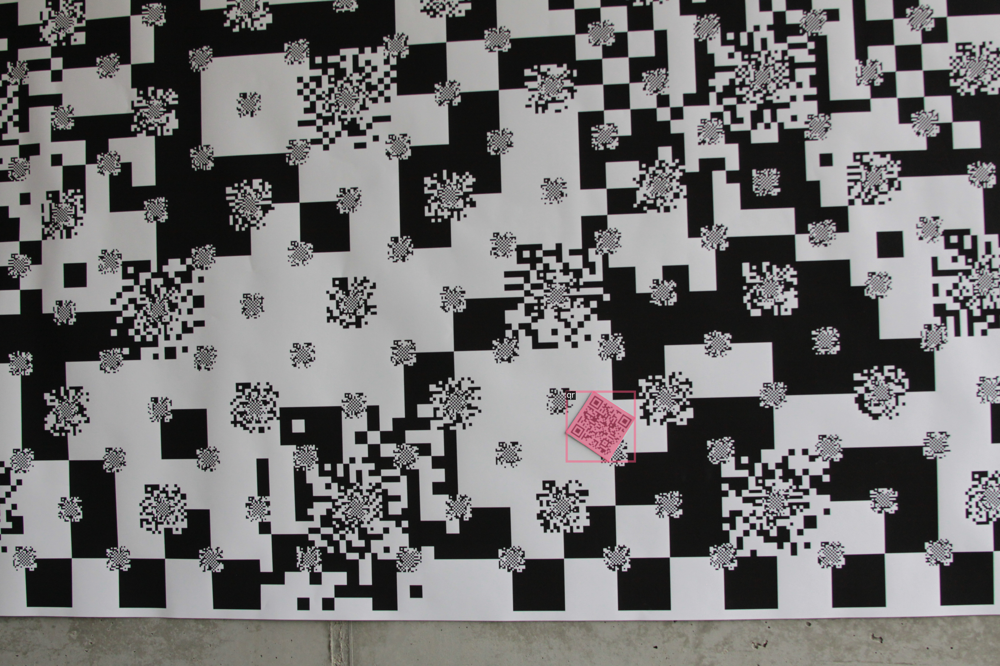

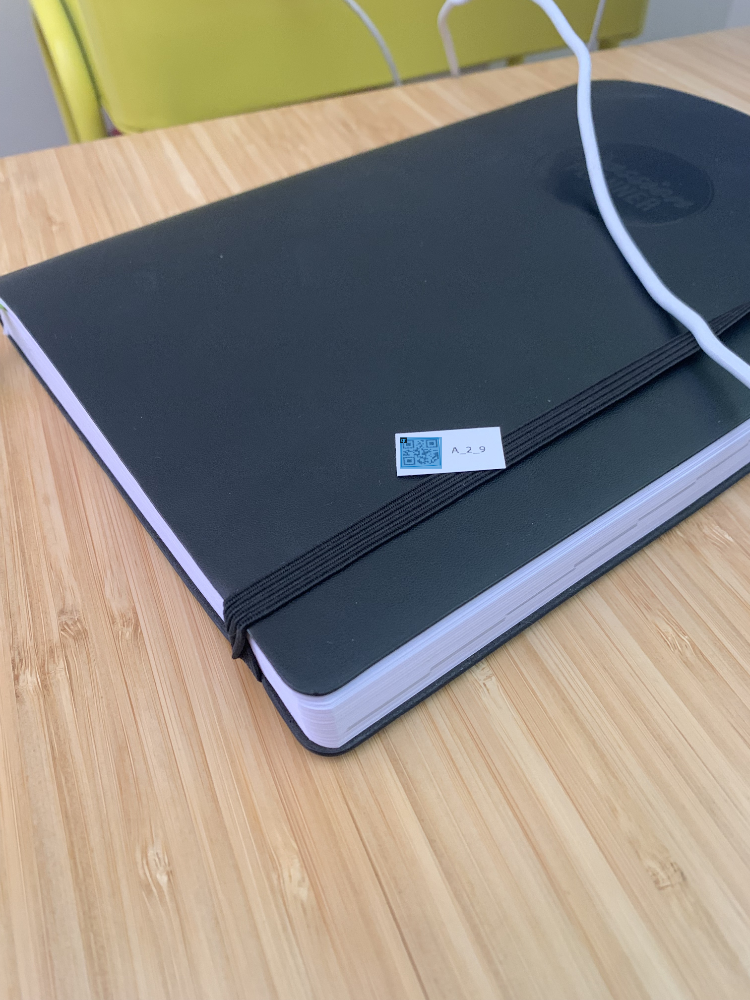

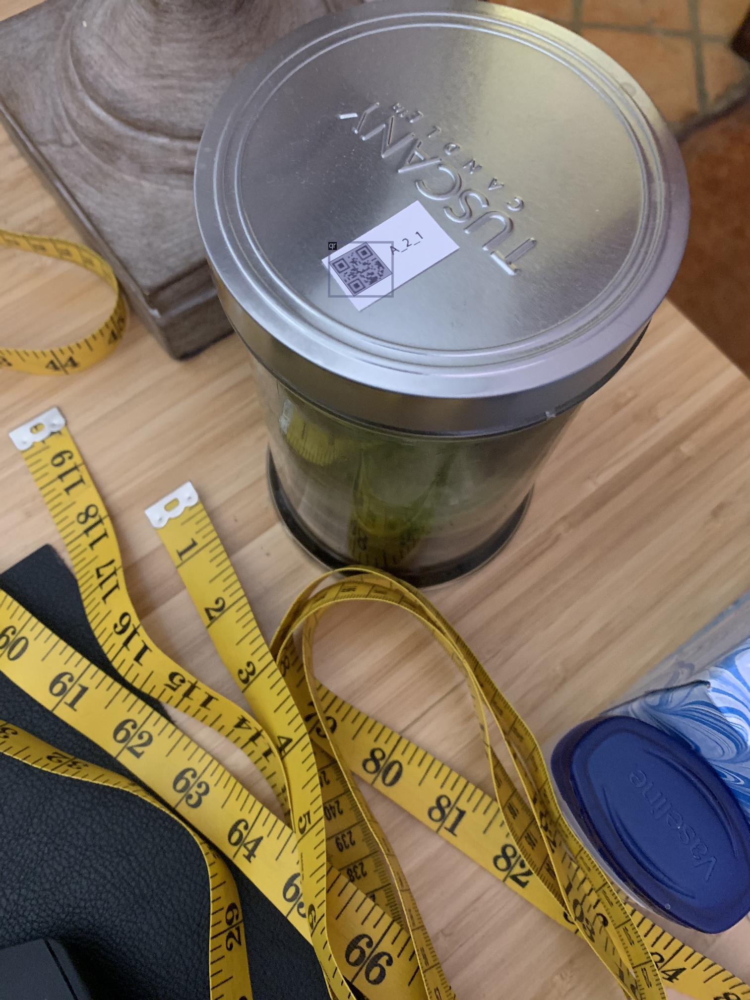

In [ ]:
qr_metadata = MetadataCatalog.get("my_dataset_train")

dataset_dicts = DatasetCatalog.get("my_dataset_train")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=qr_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

## Train!

Now, let's fine-tune a COCO-pretrained R50-FPN Mask R-CNN model on the balloon dataset. It takes ~2 minutes to train 300 iterations on a P100 GPU.


In [ ]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 1000    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
# cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[02/23 01:10:52 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:03, 56.6MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[02/23 01:11:01 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[02/23 01:11:34 d2.utils.events]:  eta: 0:24:15  iter: 19  total_loss: 1.316  loss_cls: 0.5463  loss_box_reg: 0.02806  loss_mask: 0.6952  loss_rpn_cls: 0.04228  loss_rpn_loc: 0.006501  time: 1.5601  data_time: 0.2075  lr: 4.9953e-06  max_mem: 2669M
[02/23 01:12:02 d2.utils.events]:  eta: 0:23:18  iter: 39  total_loss: 1.256  loss_cls: 0.4733  loss_box_reg: 0.03043  loss_mask: 0.6837  loss_rpn_cls: 0.05149  loss_rpn_loc: 0.008285  time: 1.4782  data_time: 0.0432  lr: 9.9902e-06  max_mem: 2759M
[02/23 01:12:31 d2.utils.events]:  eta: 0:22:49  iter: 59  total_loss: 1.127  loss_cls: 0.3699  loss_box_reg: 0.02353  loss_mask: 0.6566  loss_rpn_cls: 0.04931  loss_rpn_loc: 0.007004  time: 1.4744  data_time: 0.0274  lr: 1.4985e-05  max_mem: 2759M
[02/23 01:13:00 d2.utils.events]:  eta: 0:22:13  iter: 79  total_loss: 0.973  loss_cls: 0.2572  loss_box_reg: 0.02175  loss_mask: 0.6235  loss_rpn_cls: 0.04068  loss_rpn_loc: 0.00747  time: 1.4607  data_time: 0.0711  lr: 1.998e-05  max_mem: 2759M
[02/23

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Inference & evaluation using the trained model
Now, let's run inference with the trained model on the balloon validation dataset. First, let's create a predictor using the model we just trained:



In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

Then, we randomly select several samples to visualize the prediction results.

[02/23 01:50:26 d2.data.datasets.coco]: Loaded 8 images in COCO format from /content/drive/MyDrive/dmac/qr-codes/val/qr-val.json


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


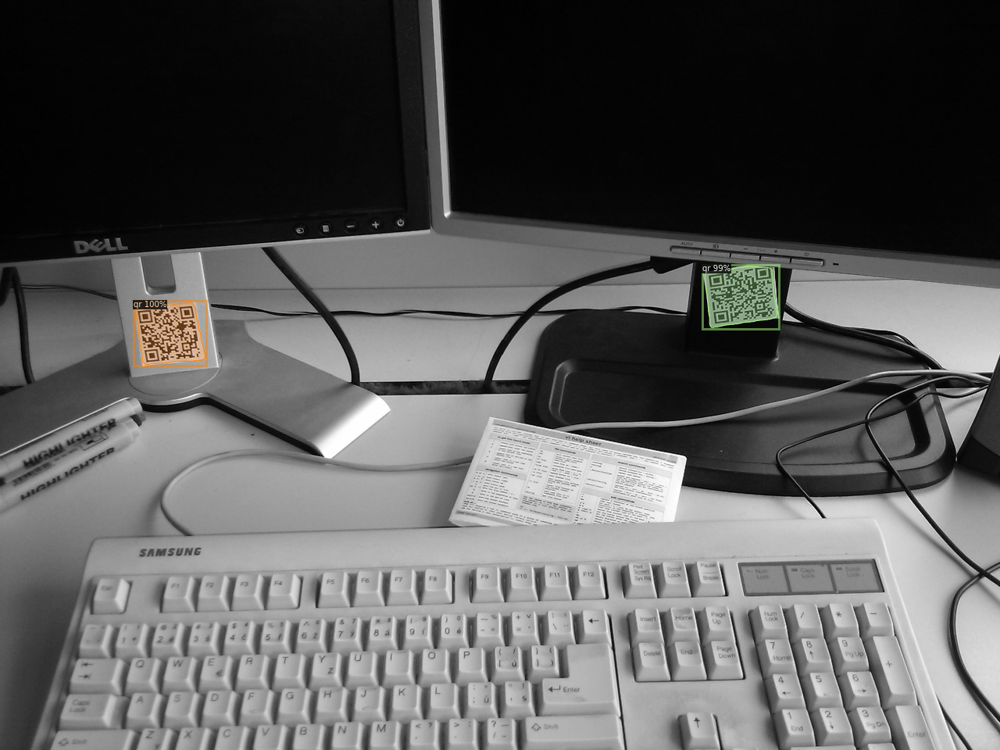

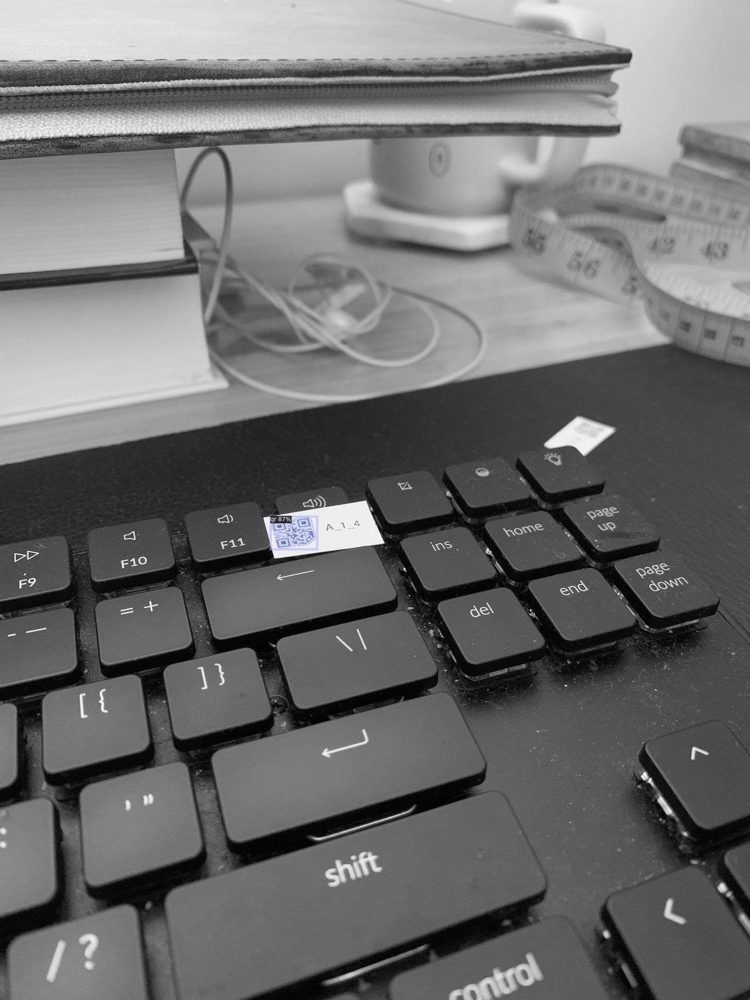

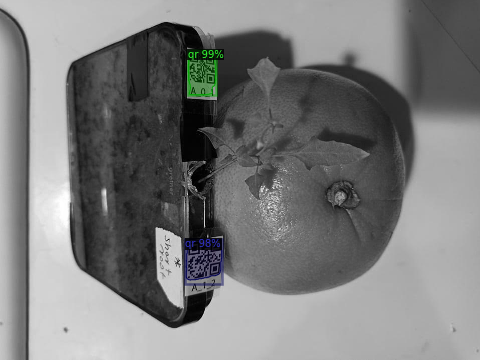

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("my_dataset_val")

for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=qr_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    



We can also evaluate its performance using AP metric implemented in COCO API.
This gives an AP of ~70. Not bad!

[{'file_name': '/content/drive/MyDrive/dmac/qr-codes/val/IMG_0173 2.jpeg', 'height': 4032, 'width': 3024, 'image_id': 1, 'annotations': [{'iscrowd': 0, 'bbox': [1088.9999999999993, 2077.1999999999985, 192.59999999999968, 140.4000000000001], 'category_id': 0, 'segmentation': [[1088.9999999999993, 2102.3999999999983, 1249.1999999999991, 2077.1999999999985, 1281.599999999999, 2194.1999999999985, 1115.999999999999, 2217.5999999999985]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}]}, {'file_name': '/content/drive/MyDrive/dmac/qr-codes/val/IMG_0179 2.jpeg', 'height': 4032, 'width': 3024, 'image_id': 2, 'annotations': [{'iscrowd': 0, 'bbox': [1681.90909090909, 1624.6363636363628, 198.54545454545428, 116.45454545454527], 'category_id': 0, 'segmentation': [[1880.4545454545444, 1712.4545454545446, 1819.3636363636354, 1624.6363636363628, 1681.90909090909, 1649.4545454545446, 1731.5454545454536, 1741.090909090908]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}]}, {'file_name': '/content/drive/MyDrive/dmac/qr-codes

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


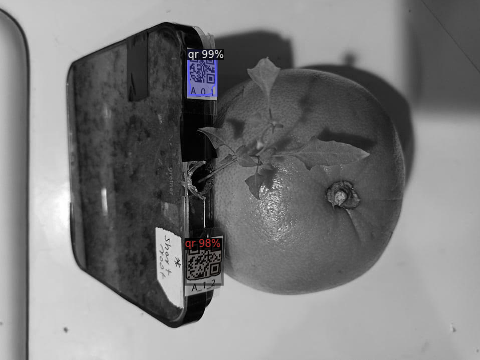

In [ ]:
print(dataset_dicts)

im = cv2.imread('/content/drive/MyDrive/dmac/qr-codes/val/unnamed-2.jpg')
outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format

v = Visualizer(im[:, :, ::-1],
  metadata=qr_metadata, 
  scale=0.5, 
  instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
)

out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])



In [ ]:
!pip install pyzbar
!apt-get install zbar-tools

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-470
Use 'apt autoremove' to remove it.
The following additional packages will be installed:
  fonts-droid-fallback fonts-noto-mono ghostscript gsfonts
  imagemagick-6-common libcupsfilters1 libcupsimage2 libgs9 libgs9-common
  libijs-0.35 libjbig2dec0 liblqr-1-0 libmagickcore-6.q16-3
  libmagickwand-6.q16-3 libv4l-0 libv4lconvert0 libzbar0 poppler-data
Suggested packages:
  fonts-noto ghostscript-x libmagickcore-6.q16-3-extra poppler-utils
  fonts-japanese-mincho | fonts-ipafont-mincho fonts-japanese-gothic
  | fonts-ipafont-gothic fonts-arphic-ukai fonts-arphic-uming fonts-nanum
The following NEW packages will be installed:
  fonts-droid-fallback fonts-noto-mono ghostscript gsfonts
  imagemagick-6-common libcupsfilters1 libcupsimage2 libgs9 libgs9-common
  libijs-0.35 libjbig2dec0 liblqr-1-0 libm

Boxes(tensor([[375.2484, 100.5319, 431.7589, 190.7747],
        [370.8759, 478.8653, 444.1517, 568.8265]], device='cuda:0'))
tensor([375.2484, 100.5319, 431.7589, 190.7747], device='cuda:0')


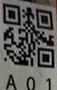

[Decoded(data=b'A-0-1', type='QRCODE', rect=Rect(left=3, top=3, width=51, height=65), polygon=[Point(x=3, y=3), Point(x=4, y=63), Point(x=54, y=68), Point(x=52, y=12)])]
tensor([370.8759, 478.8653, 444.1517, 568.8265], device='cuda:0')


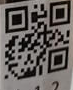

[Decoded(data=b'A-1-2', type='QRCODE', rect=Rect(left=5, top=0, width=66, height=83), polygon=[Point(x=5, y=8), Point(x=5, y=83), Point(x=67, y=68), Point(x=71, y=0)])]


In [ ]:
from pyzbar.pyzbar import decode
from pyzbar.pyzbar import ZBarSymbol

import matplotlib as plt

print(outputs["instances"].pred_boxes)

pred_boxes = outputs["instances"].pred_boxes

for bbox in pred_boxes:
  print(bbox)

  # (x0, y0, x1, y1)

  x0 = round(bbox[0].item())
  y0 = round(bbox[1].item())
  x1 = round(bbox[2].item())
  y1 = round(bbox[3].item())

  crop_img = im[ y0:y1, x0:x1]
  cv2_imshow(crop_img)

  # zbar
  results = decode(crop_img, symbols=[ZBarSymbol.QRCODE])
  print(results)


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


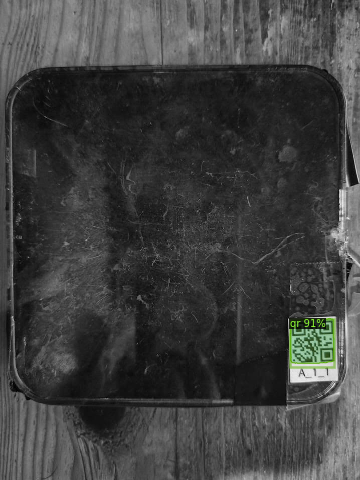

tensor([579.7307, 637.1100, 667.8252, 733.2655], device='cuda:0')


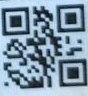

[Decoded(data=b'A-1-1', type='QRCODE', rect=Rect(left=1, top=4, width=86, height=85), polygon=[Point(x=1, y=8), Point(x=5, y=89), Point(x=87, y=86), Point(x=84, y=4)])]


In [ ]:
im = cv2.imread('/content/drive/MyDrive/dmac/qr-codes/val/unnamed.jpg')
outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format

v = Visualizer(im[:, :, ::-1],
  metadata=qr_metadata, 
  scale=0.5, 
  instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
)

out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

pred_boxes = outputs["instances"].pred_boxes

for bbox in pred_boxes:
  print(bbox)

  # (x0, y0, x1, y1)

  x0 = round(bbox[0].item())
  y0 = round(bbox[1].item())
  x1 = round(bbox[2].item())
  y1 = round(bbox[3].item())

  crop_img = im[ y0:y1, x0:x1]
  cv2_imshow(crop_img)

  # zbar
  results = decode(crop_img, symbols=[ZBarSymbol.QRCODE])
  print(results)


In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("my_dataset_val", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "my_dataset_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[02/23 02:55:27 d2.data.datasets.coco]: Loaded 8 images in COCO format from /content/drive/MyDrive/dmac/qr-codes/val/qr-val.json
[02/23 02:55:27 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|     qr     | 10           |
|            |              |
[02/23 02:55:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[02/23 02:55:27 d2.data.common]: Serializing 8 elements to byte tensors and concatenating them all ...
[02/23 02:55:27 d2.data.common]: Serialized dataset takes 0.00 MiB
[02/23 02:55:27 d2.evaluation.evaluator]: Start inference on 8 batches


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


[02/23 02:55:33 d2.evaluation.evaluator]: Total inference time: 0:00:01.204668 (0.401556 s / iter per device, on 1 devices)
[02/23 02:55:33 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.339734 s / iter per device, on 1 devices)
[02/23 02:55:33 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[02/23 02:55:33 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[02/23 02:55:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[02/23 02:55:33 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[02/23 02:55:33 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.00 seconds.
[02/23 02:55:33 d2.evaluation.fast_eval_api]: Accumulating evaluation results...
[02/23 02:55:33 d2.evaluation.fast_eval_api]: COCOeval_opt.accumulate() finished in 0.00 seconds.
 Average Precision  (AP)